In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
import glob
import os

# Imports para 3D e Animação
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Configura o estilo dos gráficos
plt.style.use(['science', 'notebook', 'grid'])

# AUMENTA O LIMITE DE TAMANHO DA ANIMAÇÃO (EM MB)
plt.rcParams['animation.embed_limit'] = 25.0

In [8]:
def carregar_dados(pasta):
    """
    Lê todos os arquivos .dat da pasta especificada,
    extrai os parâmetros (beta, theta, phi) E a "tag" (graph_id) 
    do nome do arquivo e armazena os dados da trajetória (t, x, y, z).
    
    Espera nomes de arquivo no formato: 
    [beta]_[theta]_[phi]-tag-[graph_id].dat
    Ex: "0.0005_1.15_ 0.13-tag-3.dat" 
    (Baseado no seu log de erro)
    """
    arquivos = glob.glob(os.path.join(pasta, '*.dat'))
    dados = {}
    
    print("Arquivos encontrados:")
    
    for arq_path in arquivos:
        nome_arq = os.path.basename(arq_path)
        print(f"- {nome_arq}") # Log para o usuário
        
        nome_params = nome_arq.replace('.dat', '')
        
        try:
            # 1. Divide o nome pelo separador "-tag-"
            # Ex: "0.0005_1.45_ 0.08-tag-1" vira
            #     ["0.0005_1.45_ 0.08", "1"]
            partes_principais = nome_params.split('-tag-')
            
            if len(partes_principais) != 2:
                print(f"  Aviso: Pulando {nome_arq} (não contém '-tag-' ou formato inesperado)")
                continue
                
            # 2. Pega a Tag ID (a segunda parte)
            graph_id_str = partes_principais[1]
            graph_id = int(graph_id_str.strip())
            
            # 3. Pega o bloco de parâmetros (a primeira parte)
            # Ex: "0.0005_1.45_ 0.08"
            params_str_bloco = partes_principais[0]
            
            # 4. Divide o bloco de parâmetros por "_"
            # Ex: ["0.0005", "1.45", " 0.08"]
            params_partes = params_str_bloco.split('_')
            
            if len(params_partes) < 3:
                print(f"  Aviso: Pulando {nome_arq} (não tem 3 parâmetros antes de '-tag-')")
                continue
                
            # 5. Converte os parâmetros (o .strip() remove espaços extras)
            beta = float(params_partes[0].strip())
            theta = float(params_partes[1].strip())
            phi = float(params_partes[2].strip())
            
            # Colunas: 0=t, 1=x, 2=y, 3=z
            array_dados = pd.read_csv(arq_path, sep='\\s+', header=None).to_numpy().T
            
            # Armazena no dicionário
            dados[nome_arq] = {
                'beta': beta,
                'theta': theta,
                'phi': phi,
                'graph_id': graph_id, # A tag foi lida corretamente
                'dados': array_dados
            }
            print(f"  -> Sucesso! (beta={beta}, theta={theta}, phi={phi}, tag={graph_id})")
            
        except (IndexError, ValueError) as e:
            print(f"  Erro ao processar o arquivo {nome_arq}: {e}")
            
    return dados

def obter_label(params):
    """
    Cria uma string LaTeX formatada para a legenda do gráfico.
    (Função mantida do original)
    """
    return (f"$\\beta_0/m_b = {params['beta']:.4f}$, "
            f"$\\theta_0 = {params['theta']:.2f}$, "
            f"$\\phi_0 = {params['phi']:.2f}$")

# Carrega todos os dados
pasta_dados = './graphics_out/' # Mantido do notebook original
dados_trajetoria = carregar_dados(pasta_dados)

print("\nDados carregados no dicionário (com tags):")
if not dados_trajetoria:
    print("(Nenhum dado carregado, verifique os avisos acima)")
else:
    for chave, info in dados_trajetoria.items():
        print(f"- {chave} (Tag ID: {info.get('graph_id', 'N/A')})")

Arquivos encontrados:
- 0.0005_1.15_-0.10-tag-1.dat
  -> Sucesso! (beta=0.0005, theta=1.15, phi=-0.1, tag=1)
- 0.0005_1.45_ 0.05-tag-1.dat
  -> Sucesso! (beta=0.0005, theta=1.45, phi=0.05, tag=1)
- 0.0001_1.15_ 0.10-tag-2.dat
  -> Sucesso! (beta=0.0001, theta=1.15, phi=0.1, tag=2)
- 0.0005_1.15_ 0.10-tag-1.dat
  -> Sucesso! (beta=0.0005, theta=1.15, phi=0.1, tag=1)
- 0.0005_1.15_ 0.10-tag-2.dat
  -> Sucesso! (beta=0.0005, theta=1.15, phi=0.1, tag=2)
- 0.0010_1.15_ 0.10-tag-2.dat
  -> Sucesso! (beta=0.001, theta=1.15, phi=0.1, tag=2)
- 0.0005_1.15_ 0.10-tag-3.dat
  -> Sucesso! (beta=0.0005, theta=1.15, phi=0.1, tag=3)

Dados carregados no dicionário (com tags):
- 0.0005_1.15_-0.10-tag-1.dat (Tag ID: 1)
- 0.0005_1.45_ 0.05-tag-1.dat (Tag ID: 1)
- 0.0001_1.15_ 0.10-tag-2.dat (Tag ID: 2)
- 0.0005_1.15_ 0.10-tag-1.dat (Tag ID: 1)
- 0.0005_1.15_ 0.10-tag-2.dat (Tag ID: 2)
- 0.0010_1.15_ 0.10-tag-2.dat (Tag ID: 2)
- 0.0005_1.15_ 0.10-tag-3.dat (Tag ID: 3)


Plotando dados para Gráfico A (Tag ID = 1)...
  - Plotando 0.0005_1.15_ 0.10-tag-1.dat
  - Plotando 0.0005_1.15_-0.10-tag-1.dat
  - Plotando 0.0005_1.45_ 0.05-tag-1.dat
Gráfico 'grafA.pdf' salvo.


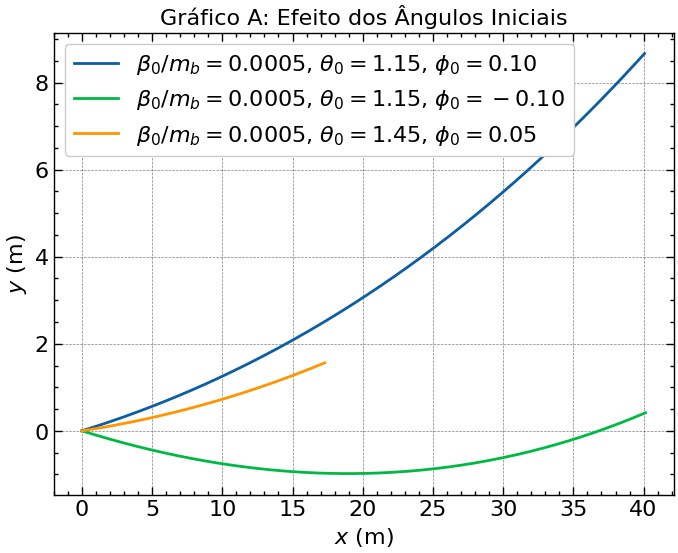

In [9]:
plt.figure(figsize=(8, 6))

TAG_GRAF_A = 1

print(f"Plotando dados para Gráfico A (Tag ID = {TAG_GRAF_A})...")

# Filtra dinamicamente o dicionário 'dados_trajetoria' pela tag
# em vez de usar uma lista manual.

# (Usamos sorted para garantir uma ordem de plotagem consistente)
arquivos_encontrados_A = sorted(dados_trajetoria.keys())

count_A = 0
for nome_arq in arquivos_encontrados_A:
    info = dados_trajetoria[nome_arq]
    
    # Filtra pela "tag"
    if info.get('graph_id') == TAG_GRAF_A:
        dados = info['dados']
        # dados[1] -> x, dados[2] -> y
        plt.plot(dados[1], dados[2], label=obter_label(info))
        print(f"  - Plotando {nome_arq}")
        count_A += 1

if count_A == 0:
    print(f"  - Nenhum arquivo encontrado para o Gráfico A (Tag ID = {TAG_GRAF_A}).")
    
plt.title(r'Gráfico A: Efeito dos Ângulos Iniciais')
plt.xlabel(r'$x$ (m)')
plt.ylabel(r'$y$ (m)')
plt.legend()
plt.savefig('grafA.pdf')
print("Gráfico 'grafA.pdf' salvo.")
plt.show()

Plotando dados para Gráfico B (Tag ID = 2)...
  - Plotando 0.0001_1.15_ 0.10-tag-2.dat
  - Plotando 0.0005_1.15_ 0.10-tag-2.dat
  - Plotando 0.0010_1.15_ 0.10-tag-2.dat
Gráfico 'grafB.pdf' salvo.


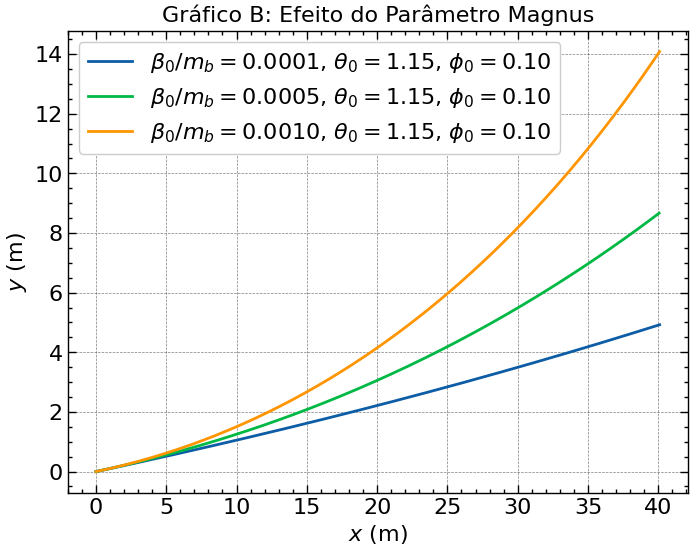

In [10]:
# Célula [4] (b4c40bd1) - MODIFICADA

plt.figure(figsize=(8, 6))

# A "tag" para o Gráfico B é graph_id = 2 (visto em exercicio.f90)
TAG_GRAF_B = 2

print(f"Plotando dados para Gráfico B (Tag ID = {TAG_GRAF_B})...")

# Filtra dinamicamente o dicionário 'dados_trajetoria' pela tag
arquivos_encontrados_B = sorted(dados_trajetoria.keys())

count_B = 0
for nome_arq in arquivos_encontrados_B:
    info = dados_trajetoria[nome_arq]
    
    # Filtra pela "tag"
    if info.get('graph_id') == TAG_GRAF_B:
        dados = info['dados']
        plt.plot(dados[1], dados[2], label=obter_label(info))
        print(f"  - Plotando {nome_arq}")
        count_B += 1

if count_B == 0:
     print(f"  - Nenhum arquivo encontrado para o Gráfico B (Tag ID = {TAG_GRAF_B}).")
    
plt.title(r'Gráfico B: Efeito do Parâmetro Magnus')
plt.xlabel(r'$x$ (m)')
plt.ylabel(r'$y$ (m)')
plt.legend()
plt.savefig('grafB.pdf')
print("Gráfico 'grafB.pdf' salvo.")
plt.show()

Buscando dados para Gráfico C/Animação (Tag ID = 3)...
  - Dados encontrados: 0.0005_1.15_ 0.10-tag-3.dat
Gráfico 'grafC.pdf' salvo.


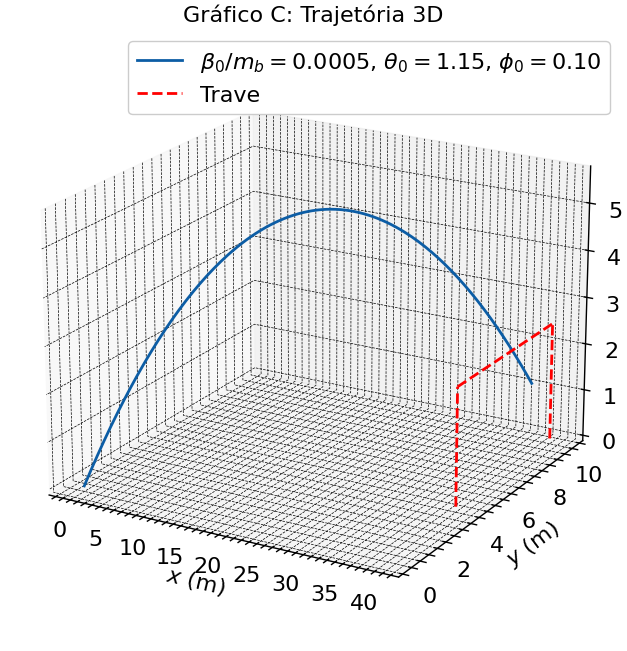

In [11]:
# Célula [5] (4581c8cf) - MODIFICADA

# A "tag" para o Gráfico C (Animação) é graph_id = 3 (visto em exercicio.f90)
TAG_GRAF_C = 3

print(f"Buscando dados para Gráfico C/Animação (Tag ID = {TAG_GRAF_C})...")

# Filtra o dicionário para encontrar o arquivo da animação
# (Normalmente será apenas um arquivo)

x, y, z = None, None, None
nome_arq_C = None
info_c = None # Vamos precisar disso na próxima célula

for nome_arq, info in dados_trajetoria.items():
    if info.get('graph_id') == TAG_GRAF_C:
        dados_c = info['dados']
        x, y, z = dados_c[1], dados_c[2], dados_c[3]
        nome_arq_C = nome_arq
        info_c = info # Armazena info para o label
        print(f"  - Dados encontrados: {nome_arq_C}")
        break # Encontramos o primeiro, paramos

if nome_arq_C is None:
    print(f"  - Nenhum arquivo encontrado para o Gráfico C (Tag ID = {TAG_GRAF_C}).")
else:
    # Plota o gráfico 3D estático (como no original)
    
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    
    # Plota a trajetória
    ax.plot(x, y, z, label=obter_label(info_c))
    
    # Plota o gol (conforme PDF)
    # Vértices: (40, 4, 2.5) e (40, 10, 2.5)
    # Trave 1
    ax.plot([40, 40], [4, 4], [0, 2.5], color='red', linestyle='--', label='Trave')
    # Trave 2
    ax.plot([40, 40], [10, 10], [0, 2.5], color='red', linestyle='--')
    # Travessão
    ax.plot([40, 40], [4, 10], [2.5, 2.5], color='red', linestyle='--')
    
    ax.set_title(r'Gráfico C: Trajetória 3D')
    ax.set_xlabel(r'$x$ (m)')
    ax.set_ylabel(r'$y$ (m)')
    ax.set_zlabel(r'$z$ (m)')
    ax.legend()
    
    # Ajusta o ângulo de visão para melhor visualização
    ax.view_init(elev=20., azim=-60)
    
    plt.savefig('grafC.pdf')
    print("Gráfico 'grafC.pdf' salvo.")
    plt.show()

In [12]:
if nome_arq_C is not None:
    x_anim, y_anim, z_anim = x, y, z # Usa os dados carregados dinamicamente

    # Configuração da figura para animação (mantido do original)
    fig_anim = plt.figure(figsize=(10, 8))
    ax_anim = fig_anim.add_subplot(111, projection='3d')
    
    # Plota o gol
    ax_anim.plot([40, 40], [4, 4], [0, 2.5], color='red', linestyle='--', label='Trave')
    ax_anim.plot([40, 40], [10, 10], [0, 2.5], color='red', linestyle='--')
    ax_anim.plot([40, 40], [4, 10], [2.5, 2.5], color='red', linestyle='--')
    
    ax_anim.set_xlabel(r'$x$ (m)')
    ax_anim.set_ylabel(r'$y$ (m)')
    ax_anim.set_zlabel(r'$z$ (m)')
    ax_anim.set_title(r'Animação C: Trajetória 3D')
    
    # Define os limites (importante para a animação)
    ax_anim.set_xlim([0, np.max(x_anim) * 1.1])
    ax_anim.set_ylim([np.min(y_anim) * 1.1, np.max(y_anim) * 1.1])
    ax_anim.set_zlim([0, np.max(z_anim) * 1.1])
    
    # Usa o info_c da célula anterior para o label
    linha = ax_anim.plot(x_anim[0:1], y_anim[0:1], z_anim[0:1], label=obter_label(info_c))[0]
    bola = ax_anim.plot(x_anim[0:1], y_anim[0:1], z_anim[0:1], 'o', color='red')[0]
    ax_anim.legend()
    
    def init():
        linha.set_data_3d([], [], [])
        bola.set_data_3d([], [], [])
        return linha, bola

    def animate(i):
        linha.set_data_3d(x_anim[:i], y_anim[:i], z_anim[:i])
        bola.set_data_3d(x_anim[i:i+1], y_anim[i:i+1], z_anim[i:i+1])
        return linha, bola

    # Reduzir o número de frames pode ajudar se a animação ficar muito grande
    # (O seu notebook original usa 2, vamos manter)
    frames = np.arange(0, len(x_anim), 2)
    
    anim = FuncAnimation(
        fig_anim, 
        animate, 
        init_func=init, 
        frames=frames, 
        interval=20, 
        blit=True
    )
    
    # Fecha o plot estático para mostrar apenas a animação
    plt.close(fig_anim)

    # Salva a animação
    print("Salvando animação como 'animacaoC.mp4'...")
    anim.save('animacaoC.mp4', writer='ffmpeg', fps=30)
    print("...Salvo com sucesso!")

    # Exibe a animação no notebook
    print("Gerando animação para o notebook...")
    display(HTML(anim.to_jshtml()))

else:
    print("Animação pulada pois dados da Tag ID 3 não foram carregados.")

Salvando animação como 'animacaoC.mp4'...
...Salvo com sucesso!
Gerando animação para o notebook...


Animation size has reached 26582205 bytes, exceeding the limit of 26214400.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
